# Optimization Tests

This notebook describes a case with ten objects, extracted from the EL-COSMOS catalog, with and without overlapping spectra.

In [1]:
import pickle
import random
import glob
from tqdm.auto import tqdm
import re
from matplotlib import pyplot as plt
import numpy as np
from scipy import interpolate, integrate, sparse
import timeit 

import frame_optics
import spec_imager
import galaxy
import consts
import tools
import optimize

import importlib
from astropy.table import Table
from astropy.io import fits

import argparse
import os

## Without Overlapping Spectra

We first analyze a case without spectra cross-contamination, positioning the galaxies on a regular grid

### Catalog loading

Load the catalog from the examples FITS files

In [2]:
n=10

cat = Table.read('data/examples/catalog.fits')

spectra = []
redshift = []
ids=[]

for i in range(n):
    objid = cat[i]['Id']
    redshift.append(cat[i]['redshift'])
    path = f'data/examples/spec_incident_{objid}.fits'
    spectrum = Table.read(path)
    wavelength_min = min(spectrum['wavelength'])
    wavelength_max = max(spectrum['wavelength'])
    spectra.append(spectrum)
    ids.append(objid)

### Set galaxy parameters 

We procede to create a list of **Galaxy** objects, positioned on a regular grid and with morphological parameters randomly extracted. They all have H$\alpha$ flux above 1.5e-16, 0.9<z<1.8. 

In [3]:
seed=1
np.random.seed(seed)
ra=np.ones(n)
dec=np.zeros(n)-0.02
for i in range(n):
    dec[i]=dec[i]+0.04/n*(i)
fwhm = np.random.uniform(0, 1, n)
axis_ratio = np.random.uniform(0, 1, n)
pa = np.random.uniform(0, 180, n)
nlines = 11

galaxy_list = []
for i in range(n):
    galaxy_list.append(galaxy.Galaxy(
        ra=ra[i], 
        dec=dec[i], 
        fwhm_arcsec=fwhm[i],
        axis_ratio=axis_ratio[i],
        pa=pa[i],
        redshift=redshift[i],
        obs_wavelength_range=(wavelength_min, wavelength_max+300),
        nlines=nlines, 
        profile='gaussian'
    ))  
fluxes=np.zeros((n,nlines))
for i in range(n):
    fluxes[i][0] = cat[i]['flux_Ha']
    fluxes[i][1] = 0
    fluxes[i][2] = 0
    fluxes[i][3] = 0
    fluxes[i][4] = 0
    fluxes[i][5] = cat[i]['flux_Hb']
    fluxes[i][6] = cat[i]['flux_OIIIa']
    fluxes[i][7] = cat[i]['flux_OIIIb']
    fluxes[i][8] = 0
    fluxes[i][10] = cat[i]['flux_SIIb']
    fluxes[i][9] = cat[i]['flux_SIIIa']
for gal_i, g in enumerate(galaxy_list):
    g.params['fluxes_emlines']=fluxes[gal_i]

### Instrumental settings 

We now need to set the instrument parameters and we need to define the number of frames that will be simulated, their pointing centers and the dispersion directions. We create a list of **SpecImager** objects, with each element in this list representing one frame.

In [4]:
pointing_centers = np.array([
    (3600, 0),
    (3600, 0),
    (3600, 0),
    (3600, 0)
]) / 3600 
grism_orientations = np.array ([0, 4, 180, -4])
npoint = len(pointing_centers)
frame_list = []
for i, pointing_center in enumerate(pointing_centers):
    o = frame_optics.FrameOptics(
        det_width=600,
        det_height=600,
        pointing_center=pointing_center, 
        dispersion_angle=grism_orientations[i],
        sigma2_det=2.0
    )
    frame_list.append(spec_imager.SpectralImager(o))

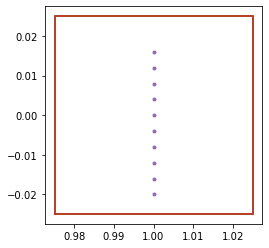

In [5]:
importlib.reload(frame_optics)

plt.subplot(111, aspect='equal')

for frame in frame_list:
    x, y = frame.optics.footprint().transpose()
    x = np.concatenate([x, [x[0]]])
    y = np.concatenate([y, [y[0]]])
    plt.plot(x, y)

plt.plot(ra, dec, ".")

### Image creation

We now simulated the spectral images associated with the catalog and the frames we defined earlier. We use the **make_image_cat** routine. 

In [6]:
wave_grid = spectrum['wavelength']
wave_grid = wave_grid.astype('float64')
new_spectra = []
for i in range(n):
    new_spectrum = spectra[i]['flux']
    new_spectra.append(new_spectrum)
images = []
for frame in tqdm(frame_list):
    image, var_image = frame.make_image_cat(galaxy_list, new_spectra, wave_grid)
    images.append((image, var_image))

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

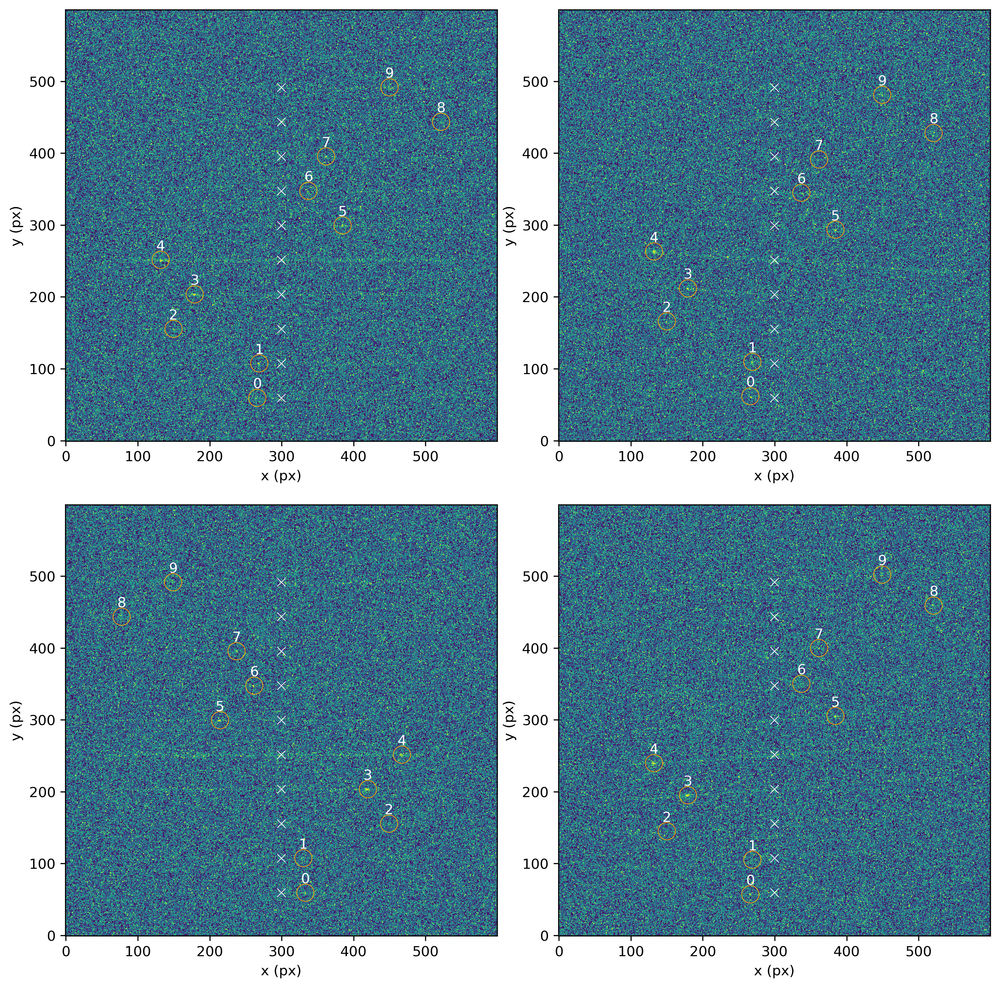

In [7]:
plt.figure(figsize=(10,10), dpi=300)
for i in tqdm(range(len(pointing_centers))):
    ax = plt.subplot(2,2,i+1, aspect='equal')
    low, high = np.percentile(images[i][0], [10,99.])
    plt.imshow(images[i][0], vmin=low, vmax=high, cmap='viridis', origin='lower')
    for gi, g in enumerate(galaxy_list):
        x, y = frame_list[i].optics.radec_to_pixel(g.params['ra'], g.params['dec'])
        wave = (1+g.params['redshift'])*6564.61
        dx, dy = frame_list[i].optics.wavelength_to_pix(wave)
        plt.scatter(x, y, marker='x', c='w', linewidth=0.5)
        circ = plt.Circle((x+dx, y+dy), radius=12, edgecolor='orange', facecolor='None', linewidth=0.5)
        ax.add_patch(circ)
        label = f"{gi}"
        plt.annotate(label, # this is the text
                 (x+dx,y+dy), # these are the coordinates to position the label
                 textcoords="offset points", # how to position the text
                 xytext=(0,7), # distance from text to points (x,y)
                 ha='center', c='white') # horizontal alignment can be left, right or center
    ax.set_xlabel("x (px)")
    ax.set_ylabel("y (px)")
plt.tight_layout()

### Optimization - Four frames, MeasureSource routine

We now proceed to estimate the parameters of interest of the simulated galaxies (continuum SED, emission line fluxes, redshift).  

In [8]:
waves=[]
extr1ds=[]
fluxess=[]
pzs=[]
new_pzs=[]
new_redshiftss=[]
redshifts=[]
logsums=[]

mask=np.ones_like(images[0][0], dtype='bool')
mask_list=[]
mask_list.append(mask)

redshift_grid=np.arange(0.9, 1.8, 3e-3)

for i in tqdm(range(n)):
    wave, extr1d, fluxes, pz, new_pz, new_redshifts, z_est, logsum=optimize.MeasureSource(
    images=images,
    frame_list=frame_list,
    mask_list=mask_list,
    test_galaxy=galaxy_list[i].copy(),
    redshift_grid=redshift_grid,
    flux_est=True, 
    )
    waves.append(wave)
    extr1ds.append(extr1d)
    fluxess.append(fluxes)
    pzs.append(pz)
    new_pzs.append(new_pz)
    new_redshiftss.append(new_redshifts)
    redshifts.append(z_est)
    logsums.append(logsum)

  0%|          | 0/10 [00:00<?, ?it/s]

Computing Jacobian done (15318, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Computing Jacobian done (19770, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

Computing Jacobian done (15318, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/100 [00:00<?, ?it/s]

Computing Jacobian done (15318, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Computing Jacobian done (15318, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Computing Jacobian done (15318, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Computing Jacobian done (15318, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

Computing Jacobian done (15318, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Computing Jacobian done (15318, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Computing Jacobian done (15318, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

### Results

In [9]:
err=np.zeros(n)
print('ID', 'z_true', 'z_est', 'sigma', 'f_true', 'f_est')
for i in range(n):
    err[i]=np.abs(redshifts[i]-redshift[i])/(1+redshift[i])
    print(ids[i], redshift[i], round(redshifts[i],4), round(err[i],4), round(galaxy_list[i].params['fluxes_emlines'][0]*1e16,2), round(fluxess[i][0],2))

ID z_true z_est sigma f_true f_est
233891 1.2472 1.2483 0.0005 3 2.36
671462 1.2529 1.2537 0.0003 2 3.48
443288 1.0096 1.0107 0.0005 2 1.67
863023 1.0697 1.0705 0.0004 6 4.77
629110 0.9732 0.9736 0.0002 5 4.81
528514 1.4893 1.4906 0.0005 3 2.59
936766 1.3922 1.3937 0.0006 2 1.69
228627 1.4425 1.4433 0.0003 2 2.04
979501 1.7685 1.7701 0.0006 2 2.0
828301 1.6224 1.6229 0.0002 3 2.55


Text(0.5, 1.0, 'Refined grid')

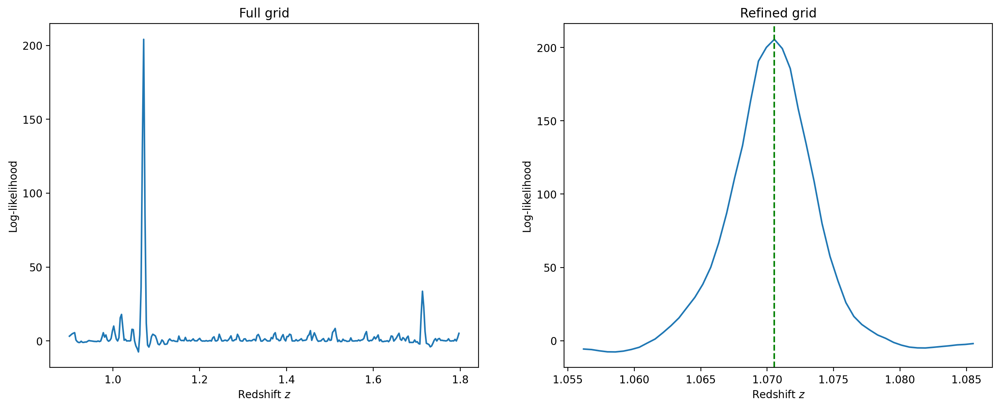

In [10]:
plt.figure(figsize=(16,6), dpi=200)
plt.subplot(1,2,1)
plt.plot(redshift_grid, pzs[3])
plt.title('Full grid')
plt.xlabel(r'Redshift $z$')
plt.ylabel(r'Log-likelihood')
plt.subplot(1,2,2)
plt.plot(new_redshiftss[3], new_pzs[3])
plt.axvline(redshifts[3], linestyle='--', color='green')
plt.xlabel(r'Redshift $z$')
plt.ylabel(r'Log-likelihood')
plt.title('Refined grid')

In [11]:
def gaussian(galaxy, wave, nlines):
    
    lines=np.zeros_like(wave)
    redshift = galaxy.params['redshift']

    for l in range(nlines):
        
        wavelength_obs = (1 + redshift) * consts.lines[l]
        sigma_size = galaxy.params['velocity_disp']/consts.c*wavelength_obs
        ampl = galaxy.params['fluxes_emlines'][l]/np.sqrt(2 * np.pi * sigma_size**2)
        gauss = ampl * np.exp(-(wave - wavelength_obs)**2/(2 * sigma_size**2)) 
        lines = lines + gauss
    
    return lines

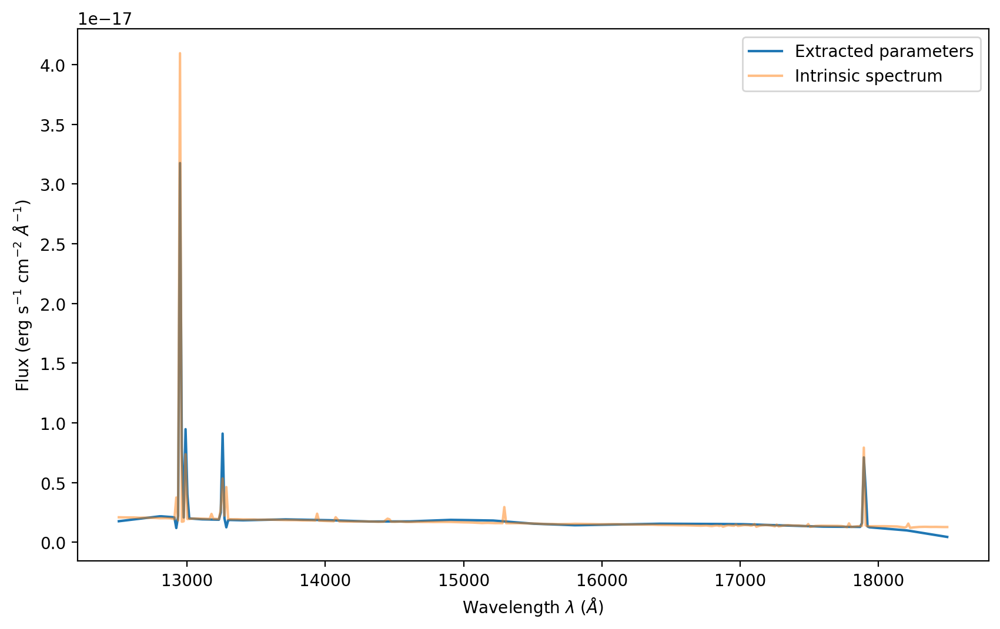

In [17]:
plt.figure(figsize=(10,6), dpi=200)
i=4#range(n)
#for i in index:
fluxes=np.ones(nlines)*fluxess[i]
ext_galaxy = galaxy.Galaxy(fluxes_emlines=fluxes*1e-16, redshift=redshifts[i], velocity_disp=galaxy_list[i].params['velocity_disp'], nlines=nlines)
ext = extr1ds[i]
ext1d_int = interpolate.interp1d(waves[i], ext)
#plt.subplot(n,2,i+1)
plt.plot(wave_grid, ext1d_int(wave_grid)*1e-18+gaussian(ext_galaxy, wave_grid, ext_galaxy.params['nlines']), label='Extracted parameters')
plt.plot(spectra[i]['wavelength'], spectra[i]['flux'], alpha=0.5, label='Intrinsic spectrum')
plt.xlabel(r'Wavelength $\lambda$ ($\AA$)')
plt.ylabel(r'Flux (erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$)')
plt.legend()

## With Overlapping Spectra

We now analyze a case with spectra cross-contamination, positioning the galaxies randomly near the center of the detector

### Set galaxy parameters

We use the same parameters as before for the galaxies, changing only the positioning. 

In [35]:
seed=1
np.random.seed(seed)

ra = np.random.uniform(-1, 1, n) * 0.01 + 1
dec = np.random.uniform(-1, 1, n) * 0.01
fwhm = np.random.uniform(0, 1, n)
axis_ratio = np.random.uniform(0, 1, n)
pa = np.random.uniform(0, 180, n)
nlines = 11

galaxy_list = []
for i in range(n):
    galaxy_list.append(galaxy.Galaxy(
        ra=ra[i], 
        dec=dec[i], 
        fwhm_arcsec=fwhm[i],
        axis_ratio=axis_ratio[i],
        pa=pa[i],
        redshift=redshift[i],
        obs_wavelength_range=(wavelength_min, wavelength_max+300),
        nlines=nlines, 
        profile='gaussian'
    ))  
fluxes=np.zeros((n,nlines))
for i in range(n):
    fluxes[i][0] = cat[i]['flux_Ha']
    fluxes[i][1] = 0
    fluxes[i][2] = 0
    fluxes[i][3] = 0
    fluxes[i][4] = 0
    fluxes[i][5] = cat[i]['flux_Hb']
    fluxes[i][6] = cat[i]['flux_OIIIa']
    fluxes[i][7] = cat[i]['flux_OIIIb']
    fluxes[i][8] = 0
    fluxes[i][10] = cat[i]['flux_SIIb']
    fluxes[i][9] = cat[i]['flux_SIIIa']
for gal_i, g in enumerate(galaxy_list):
    g.params['fluxes_emlines']=fluxes[gal_i]

### Instrumental settings 

We now need to set the instrument parameters and we need to define the number of frames that will be simulated, their pointing centers and the dispersion directions. We create a list of **SpecImager** objects, with each element in this list representing one frame.

In [19]:
pointing_centers = np.array([
    (3600, 0),
    (3600, 0),
    (3600, 0),
    (3600, 0)
]) / 3600 
grism_orientations = np.array ([0, 4, 180, -4])
npoint = len(pointing_centers)
frame_list = []
for i, pointing_center in enumerate(pointing_centers):
    o = frame_optics.FrameOptics(
        det_width=600,
        det_height=600,
        pointing_center=pointing_center,
        wavelength_0=15000,
        dispersion_angle=grism_orientations[i],
        sigma2_det=2.0
    )
    frame_list.append(spec_imager.SpectralImager(o))

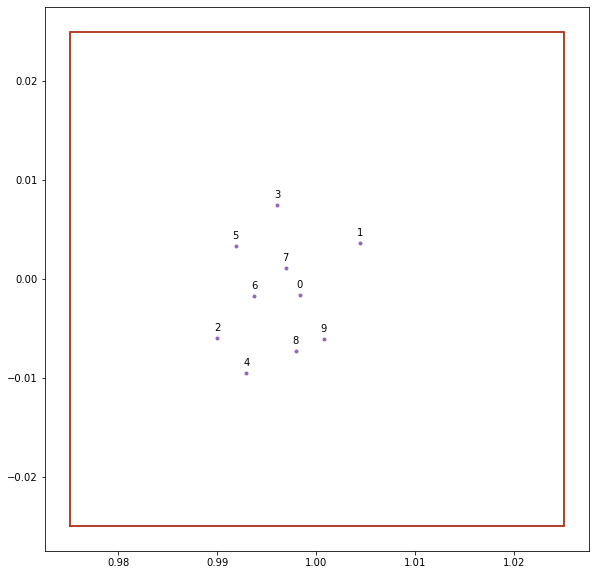

In [20]:
importlib.reload(frame_optics)

plt.figure(figsize=(10,10))
plt.subplot(111, aspect='equal')

for frame in frame_list:
    x, y = frame.optics.footprint().transpose()
    x = np.concatenate([x, [x[0]]])
    y = np.concatenate([y, [y[0]]])
    plt.plot(x, y)


plt.plot(ra, dec, ".")
for i in range(n):
    label=i
    plt.annotate(label, # this is the text
                 (ra[i],dec[i]), # these are the coordinates to position the label
                 textcoords="offset points", # how to position the text
                 xytext=(0,7), # distance from text to points (x,y)
                 ha='center', c='black') # horizontal alignment can be left, right or center

### Image creation

We now simulated the spectral images associated with the catalog and the frames we defined earlier. We use the **make_image_cat** routine. 

In [21]:
wave_grid = spectrum['wavelength']
wave_grid = wave_grid.astype('float64')
new_spectra = []
for i in range(n):
    new_spectrum = spectra[i]['flux']
    new_spectra.append(new_spectrum)
images = []
for frame in tqdm(frame_list):
    image, var_image = frame.make_image_cat(galaxy_list, new_spectra, wave_grid)
    images.append((image, var_image))

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

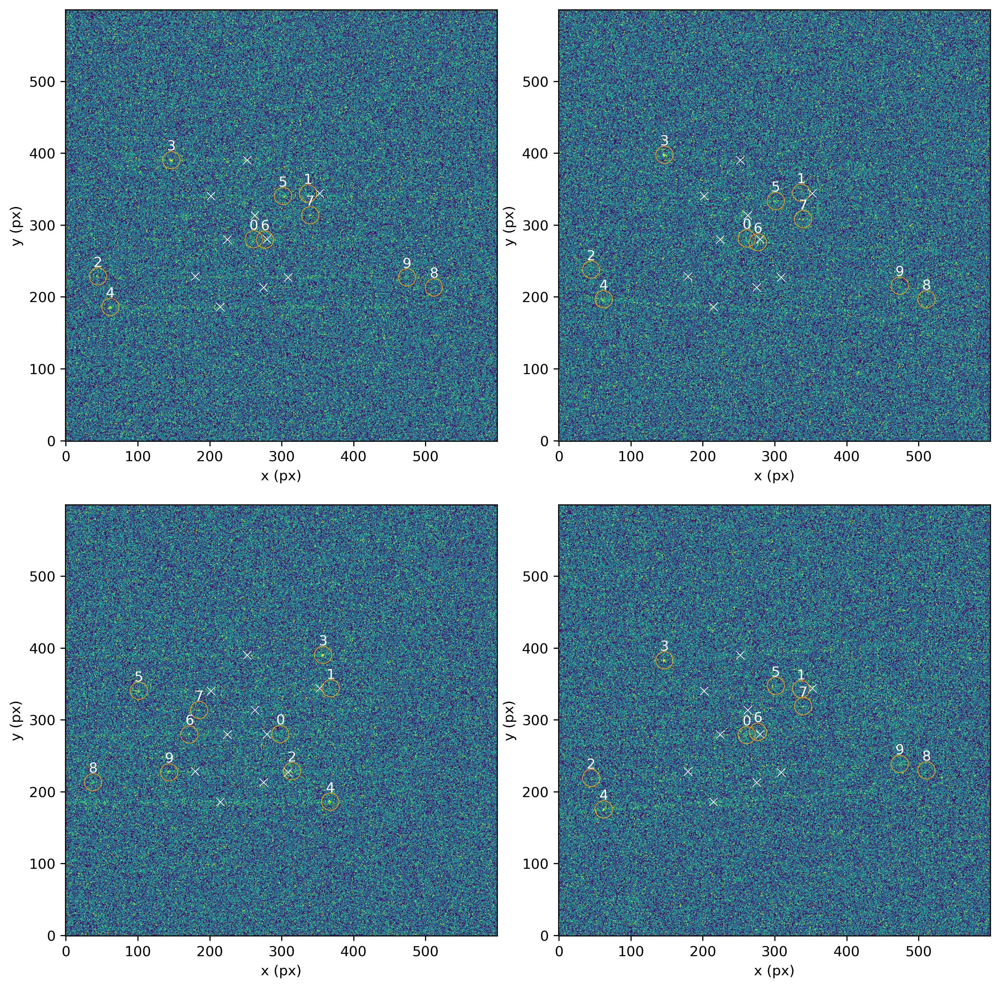

In [22]:
plt.figure(figsize=(10,10), dpi=300)

for i in tqdm(range(len(pointing_centers))):
    ax = plt.subplot(2,2,i+1, aspect='equal')
    low, high = np.percentile(images[i][0], [10,99.])
    plt.imshow(images[i][0], vmin=low, vmax=high, cmap='viridis', origin='lower')
    for gi, g in enumerate(galaxy_list):
        x, y = frame_list[i].optics.radec_to_pixel(g.params['ra'], g.params['dec'])
        wave = (1+g.params['redshift'])*6564.61
        dx, dy = frame_list[i].optics.wavelength_to_pix(wave)
        plt.scatter(x, y, marker='x', c='w', linewidth=0.5)
        circ = plt.Circle((x+dx, y+dy), radius=12, edgecolor='orange', facecolor='None', linewidth=0.5)
        ax.add_patch(circ)
        label = f"{gi}"
        plt.annotate(label, # this is the text
                 (x+dx,y+dy), # these are the coordinates to position the label
                 textcoords="offset points", # how to position the text
                 xytext=(0,7), # distance from text to points (x,y)
                 ha='center', c='white') # horizontal alignment can be left, right or center
    ax.set_xlabel("x (px)")
    ax.set_ylabel("y (px)")
plt.tight_layout()

### Optimization - Four frames, MeasureSource routine

We now proceed to estimate the parameters of interest of the simulated galaxies (continuum SED, emission line fluxes, redshift).  

In [23]:
waves=[]
extr1ds=[]
fluxess=[]
pzs=[]
new_pzs=[]
new_redshiftss=[]
redshifts=[]
logsums=[]

mask=np.ones_like(images[0][0], dtype='bool')
mask_list=[]
mask_list.append(mask)

redshift_grid=np.arange(0.9, 1.8, 3e-3)

for i in tqdm(range(n)):
    wave, extr1d, fluxes, pz, new_pz, new_redshifts, z_est, logsum=optimize.MeasureSource(
    images=images,
    frame_list=frame_list,
    mask_list=mask_list,
    test_galaxy=galaxy_list[i].copy(),
    redshift_grid=redshift_grid,
    flux_est=True
    )
    waves.append(wave)
    extr1ds.append(extr1d)
    fluxess.append(fluxes)
    pzs.append(pz)
    new_pzs.append(new_pz)
    new_redshiftss.append(new_redshifts)
    redshifts.append(z_est)
    logsums.append(logsum)

  0%|          | 0/10 [00:00<?, ?it/s]

Computing Jacobian done (19545, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

Computing Jacobian done (22313, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

5
Refining solution...


  0%|          | 0/160 [00:00<?, ?it/s]

Computing Jacobian done (13410, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Computing Jacobian done (19288, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

Computing Jacobian done (18585, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Computing Jacobian done (18111, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

3
Refining solution...


  0%|          | 0/60 [00:00<?, ?it/s]

Computing Jacobian done (14696, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

Computing Jacobian done (15039, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

Computing Jacobian done (15123, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

3
Refining solution...


  0%|          | 0/60 [00:00<?, ?it/s]

Computing Jacobian done (19440, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

### Results

In [34]:
err=np.zeros(n)
print('ID', 'z_true', 'z_est', 'sigma', 'f_true', 'f_est')
for i in range(n):
    err[i]=np.abs(redshifts[i]-redshift[i])/(1+redshift[i])
    print(i, ids[i], redshift[i], round(redshifts[i],4), round(err[i],4), round(galaxy_list[i].params['fluxes_emlines'][0]*1e16, 2), round(fluxess[i][0],2))

ID z_true z_est sigma f_true f_est
0 233891 1.2472 1.2471 0.0001 2.55 2.99
1 671462 1.2529 1.2531 0.0001 2.29 1.52
2 443288 1.0096 1.0113 0.0008 1.68 1.82
3 863023 1.0697 1.0699 0.0001 6.1 6.84
4 629110 0.9732 0.9742 0.0005 5.31 6.14
5 528514 1.4893 1.4894 0.0 2.91 2.24
6 936766 1.3922 1.3931 0.0004 1.85 2.27
7 228627 1.4425 1.4439 0.0006 2.13 1.98
8 979501 1.7685 1.7665 0.0007 1.68 1.47
9 828301 1.6224 1.6241 0.0006 2.72 2.8


Text(0.5, 1.0, 'Refined grid')

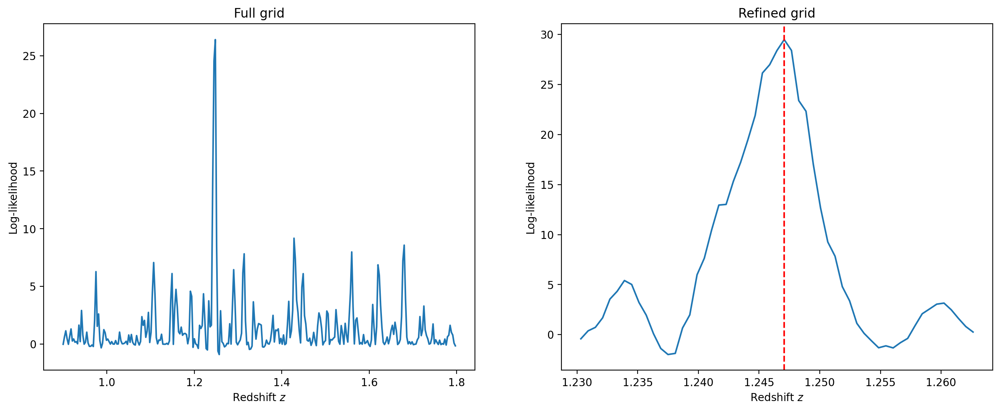

In [25]:
plt.figure(figsize=(16,6), dpi=200)
plt.subplot(1,2,1)
plt.plot(redshift_grid, pzs[0])
plt.title('Full grid')
plt.xlabel(r'Redshift $z$')
plt.ylabel(r'Log-likelihood')
plt.subplot(1,2,2)
plt.plot(new_redshiftss[0], new_pzs[0])
plt.axvline(redshifts[0], linestyle='--', color='red')
plt.xlabel(r'Redshift $z$')
plt.ylabel(r'Log-likelihood')
plt.title('Refined grid')

Text(0.5, 1.0, 'Refined grid')

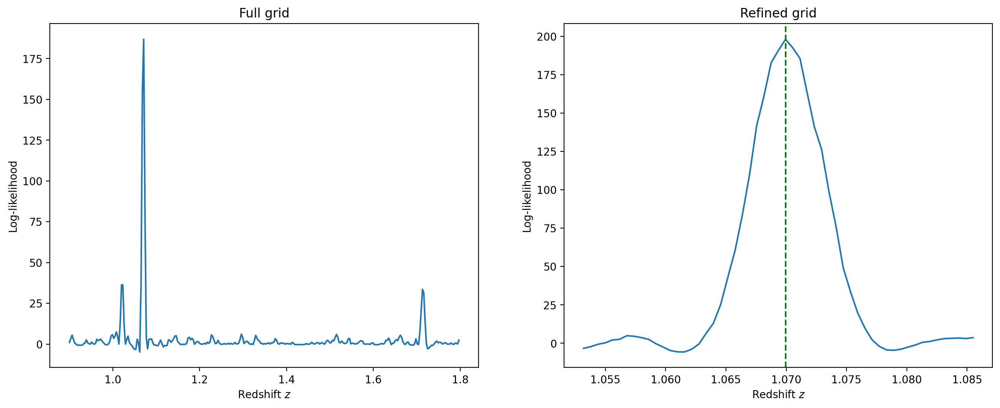

In [26]:
plt.figure(figsize=(16,6), dpi=200)
plt.subplot(1,2,1)
plt.plot(redshift_grid, pzs[3])
plt.title('Full grid')
plt.xlabel(r'Redshift $z$')
plt.ylabel(r'Log-likelihood')
plt.subplot(1,2,2)
plt.plot(new_redshiftss[3], new_pzs[3])
plt.axvline(redshifts[3], linestyle='--', color='green')
plt.xlabel(r'Redshift $z$')
plt.ylabel(r'Log-likelihood')
plt.title('Refined grid')

### Optimization - Four frames, MeasureEverything routine

In [29]:
mask=np.ones_like(images[0][0], dtype='bool')
mask_list=[]
mask_list.append(mask)

redshift_grid=np.arange(0.9, 1.8, 3e-3)

g2=[]
for i in range(n):
    g2.append(galaxy_list[i].copy())

Wave, Extr1d, Fluxes, Pz, New_pz, Logsum, New_redshifts, Z_est=optimize.MeasureEverything(
    images=images,
    frame_list=frame_list,
    mask_list=mask_list,
    galaxy_list=g2,
    redshift_grid=redshift_grid,
    flux_est=True, 
    )

Computing Jacobian done (150399, 210)


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

Estimating line fluxes...


  0%|          | 0/300 [00:00<?, ?it/s]

5
Refining solution...


  0%|          | 0/160 [00:00<?, ?it/s]

Estimating line fluxes...


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Estimating line fluxes...


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

Estimating line fluxes...


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Estimating line fluxes...


  0%|          | 0/300 [00:00<?, ?it/s]

3
Refining solution...


  0%|          | 0/60 [00:00<?, ?it/s]

Estimating line fluxes...


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

Estimating line fluxes...


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

Estimating line fluxes...


  0%|          | 0/300 [00:00<?, ?it/s]

3
Refining solution...


  0%|          | 0/60 [00:00<?, ?it/s]

Estimating line fluxes...


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

Estimating line fluxes...


In [33]:
err=np.zeros(n)
print('ID', 'z_true', 'z_est', 'sigma', 'f_true', 'f_est')
for i in range(n):
    err[i]=np.abs(Z_est[i]-redshift[i])/(1+redshift[i])
    print(i, ids[i], redshift[i], round(Z_est[i],4), round(err[i],4), round(galaxy_list[i].params['fluxes_emlines'][0]*1e16, 2), round(Fluxes[i][0],2))

ID z_true z_est sigma f_true f_est
0 233891 1.2472 1.2471 0.0001 2.55 2.97
1 671462 1.2529 1.2537 0.0003 2.29 1.5
2 443288 1.0096 1.0119 0.0011 1.68 1.69
3 863023 1.0697 1.0699 0.0001 6.1 6.87
4 629110 0.9732 0.9742 0.0005 5.31 6.19
5 528514 1.4893 1.49 0.0003 2.91 2.42
6 936766 1.3922 1.3931 0.0004 1.85 2.32
7 228627 1.4425 1.4445 0.0008 2.13 1.89
8 979501 1.7685 1.7677 0.0003 1.68 1.6
9 828301 1.6224 1.6229 0.0002 2.72 2.79


Text(0.5, 1.0, 'Refined grid')

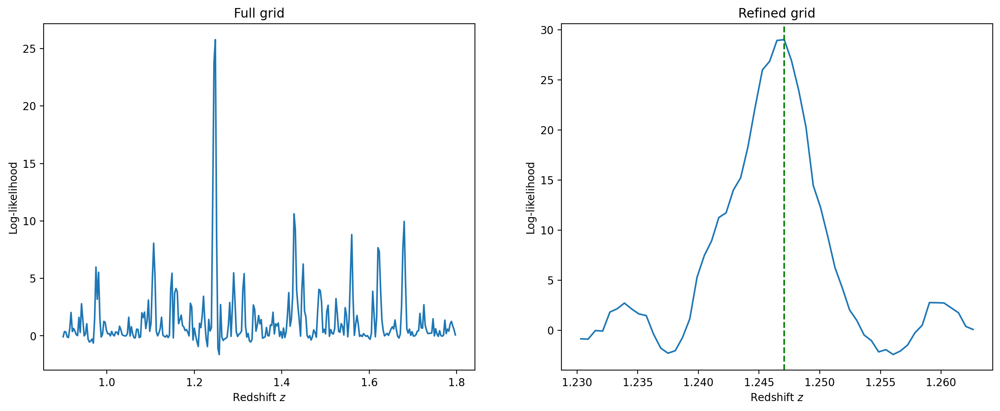

In [31]:
k=0

plt.figure(figsize=(16,6), dpi=200)
plt.subplot(1,2,1)
plt.plot(redshift_grid, Pz[k])
plt.title('Full grid')
plt.xlabel(r'Redshift $z$')
plt.ylabel(r'Log-likelihood')
plt.subplot(1,2,2)
plt.plot(New_redshifts[k], New_pz[k])
plt.axvline(Z_est[k], linestyle='--', color='green')
plt.xlabel(r'Redshift $z$')
plt.ylabel(r'Log-likelihood')
plt.title('Refined grid')

### Optimization - One frame, MeasureSource routine

In [36]:
frame_list1=[]
frame_list1.append(frame_list[0])
images1=[]
images1.append(images[0])

waves1=[]
extr1ds1=[]
fluxess1=[]
pzs1=[]
new_pzs1=[]
new_redshiftss1=[]
redshifts1=[]
logsums1=[]

mask=np.ones_like(images[0][0], dtype='bool')
mask_list=[]
mask_list.append(mask)

redshift_grid=np.arange(0.9, 1.8, 3e-3)

for i in tqdm(range(n)):
    wave, extr1d, fluxes, pz, new_pz, new_redshifts, z_est, logsum=optimize.MeasureSource(
    images=images1,
    frame_list=frame_list1,
    mask_list=mask_list,
    test_galaxy=galaxy_list[i].copy(),
    redshift_grid=redshift_grid,
    flux_est=True, 
    )
    waves1.append(wave)
    extr1ds1.append(extr1d)
    fluxess1.append(fluxes)
    pzs1.append(pz)
    new_pzs1.append(new_pz)
    new_redshiftss1.append(new_redshifts)
    redshifts1.append(z_est)
    logsums1.append(logsum)

  0%|          | 0/10 [00:00<?, ?it/s]

Computing Jacobian done (4788, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/100 [00:00<?, ?it/s]

Computing Jacobian done (5247, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

Reduced number of redshifts with refined grid from 6 to 5
5
Refining solution...


  0%|          | 0/230 [00:00<?, ?it/s]

Computing Jacobian done (3367, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

Reduced number of redshifts with refined grid from 6 to 5
5
Refining solution...


  0%|          | 0/205 [00:00<?, ?it/s]

Computing Jacobian done (3703, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

2
Refining solution...


  0%|          | 0/55 [00:00<?, ?it/s]

Computing Jacobian done (4662, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Computing Jacobian done (4545, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

4
Refining solution...


  0%|          | 0/65 [00:00<?, ?it/s]

Computing Jacobian done (3682, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Computing Jacobian done (3703, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

1
Refining solution...


  0%|          | 0/50 [00:00<?, ?it/s]

Computing Jacobian done (3710, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

Reduced number of redshifts with refined grid from 6 to 5
5
Refining solution...


  0%|          | 0/160 [00:00<?, ?it/s]

Computing Jacobian done (4680, 21)


  0%|          | 0/300 [00:00<?, ?it/s]

3
Refining solution...


  0%|          | 0/106 [00:00<?, ?it/s]

### Results

In [37]:
err=np.zeros(n)
print('ID', 'z_true', 'z_est', 'sigma', 'f_true', 'f_est')
for i in range(n):
    err[i]=np.abs(redshifts1[i]-redshift[i])/(1+redshift[i])
    print(i, ids[i], redshift[i], round(redshifts1[i],4), round(err[i],4), round(galaxy_list[i].params['fluxes_emlines'][0]*1e16,2), round(fluxess1[i][0],2))

ID z_true z_est sigma f_true f_est
0 233891 1.2472 1.2459 0.0006 2.55 4.16
1 671462 1.2529 1.1872 0.0291 2.29 3.52
2 443288 1.0096 1.0484 0.0193 1.68 -1.87
3 863023 1.0697 1.0699 0.0001 6.1 6.88
4 629110 0.9732 0.9736 0.0002 5.31 7.95
5 528514 1.4893 1.493 0.0015 2.91 4.68
6 936766 1.3922 1.4218 0.0124 1.85 1.2
7 228627 1.4425 1.4439 0.0006 2.13 2.15
8 979501 1.7685 1.3009 0.1689 1.68 2.93
9 828301 1.6224 1.4416 0.069 2.72 -0.75
